In [ ]:
import plotly.express as px
import plotly.graph_objects as go
import missingno as msno
import pandas as pd
import numpy as np
from sklearn.metrics import r2_score

In [ ]:
#from google.colab import drive
#drive.mount('/content/drive')
#path = 'your path here'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
data_original = pd.read_csv(path+'vehicles.csv')
data_original.head()

,id,url,region,region_url,price,year,manufacturer,model,condition,cylinders,...,size,type,paint_color,image_url,description,county,state,lat,long,posting_date
0,7222695916,https://prescott.craigslist.org/cto/d/prescott...,prescott,https://prescott.craigslist.org,6000,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,az,NaN,NaN,NaN
1,7218891961,https://fayar.craigslist.org/ctd/d/bentonville...,fayetteville,https://fayar.craigslist.org,11900,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,ar,NaN,NaN,NaN
2,7221797935,https://keys.craigslist.org/cto/d/summerland-k...,florida keys,https://keys.craigslist.org,21000,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,fl,NaN,NaN,NaN
3,7222270760,https://worcester.craigslist.org/cto/d/west-br...,worcester / central MA,https://worcester.craigslist.org,1500,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,ma,NaN,NaN,NaN
4,7210384030,https://greensboro.craigslist.org/cto/d/trinit...,greensboro,https://greensboro.craigslist.org,4900,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,nc,NaN,NaN,NaN


# Data Preprocessing
Before using our data to make any predictions, we need to preprocess it. The cleaning process will involve the following steps:
1. Drop irrelevant columns
2. Handle missing values
3. Remove Outliers
4. Remove Unnecessary Data
5. Remove Irregularities
6. One-hot encoding


### 1. Drop irrelevant columns

In [ ]:
# First, we will drop the columns that are not useful for our analysis and prediction.
# Information like seller location, image_url, and id are not useful for our analysis. We will drop these columns from our dataset.
drop_columns = ['lat', 'long', 'state', 'county', 'description', 'image_url', 'paint_color', 'VIN', 'title_status', 'region', 'region_url', 'url', 'id', 'posting_date']
data = data_original.drop(columns=drop_columns)

### 2. Handle missing values

price            0.000000
year             0.282281
manufacturer     4.133714
model            1.236179
condition       40.785232
cylinders       41.622470
fuel             0.705819
odometer         1.030735
transmission     0.598763
drive           30.586347
size            71.767476
type            21.752717
dtype: float64


<Axes: >

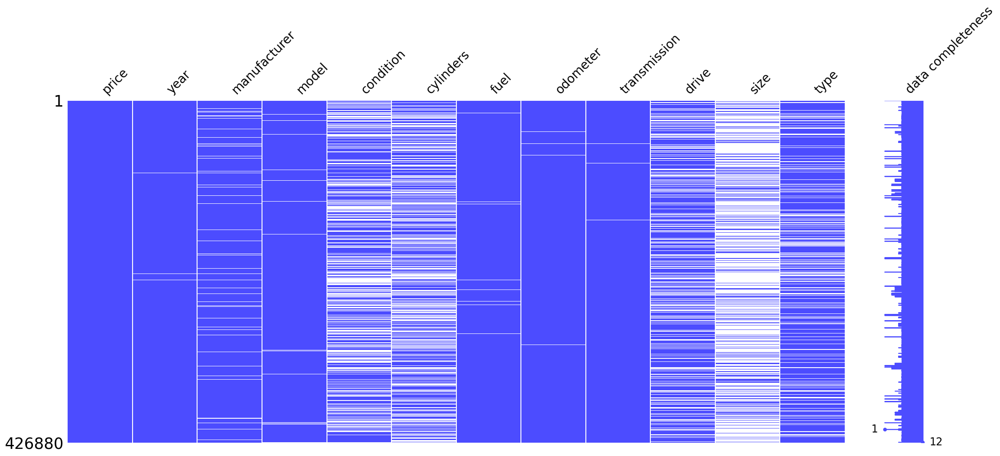

In [ ]:
# let's visualize the missing values in the dataset
# print the % of missing values in each column
missing_values = data.isnull().mean() * 100
print(missing_values)
msno.matrix(data, color=(0.3, 0.3, 1), fontsize=20, labels=True)

Here, we can see that the columns (condition, cylinders, drive, size, and type) all have significant missing values. We will look into each of these columns and decide how to handle the missing values.

**Condition**: This column has 41% missing values. Since the condition of a vehicle can be reasonably inferred from the year and mileage, we will drop this column.

**Cylinders**: This column has 42% missing values. The cylinder count will be too difficult to infer from other columns, so we will drop this column too.

**Drive**: This column has 31% missing values. Since the drive type is important in determining the price of a vehicle, we will drop the rows with missing values.

**Size**: This column has 71% missing values. We will drop the column since it's values are so sparse. Vehicle size should be highly correlated with vehicle type anyways.

**Type**: This column has 22% missing values. We will drop the rows with missing values.

In [ ]:
# drop condition column, cylinders, and size
data = data.drop(columns=['condition', 'cylinders', 'size'])
# drop rows with missing values
data = data.dropna()

### 3. Remove outliers

In [ ]:
# plot histogram of year and odometer
fig = px.histogram(data, x='year', title='Histogram of year')
fig.show()
fig = px.histogram(data, x='odometer', title='Histogram of odometer')
fig.show()

In [ ]:
categorical_columns = ['manufacturer', 'model', 'fuel', 'transmission', 'drive', 'type']
numerical_columns = ['year', 'odometer', 'price']

# Remove outliers for numerical columns, defined at 1.5 * IQR

for column in numerical_columns:
    q1 = data[column].quantile(0.25)
    q3 = data[column].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    data = data[(data[column] > lower_bound) & (data[column] < upper_bound)]

# keep only the top 20 manufacturers and top 20 models.
# This will help us reduce the number of categories in the categorical columns for one-hot encoding.
# make rows with other manufacturers and models as 'other'
top_manufacturers = data['manufacturer'].value_counts().head(20).index
data.loc[~data['manufacturer'].isin(top_manufacturers), 'manufacturer'] = 'other'
top_models = data['model'].value_counts().head(20).index
data.loc[~data['model'].isin(top_models), 'model'] = 'other'

In [ ]:
# plot histogram of year and odometer
fig = px.histogram(data, x='year', title='Histogram of year (After removing outliers)')
fig.show()
fig = px.histogram(data, x='odometer', title='Histogram of odometer (After removing outliers)')
fig.show()

### 4. Remove Unnecessary Data

In [ ]:
# plot of price
fig = px.histogram(data, x='price', title='Histogram of price', nbins=60)
fig.show()

The initial bin (ranging from 0 to 999) exhibits a disproportionately high frequency compared to the rest of the bins, suggesting that vehicles in this price range may be in a significantly deteriorated state, serving primarily as sources for parts. Our goal is to predict the market price of used cars in the context of operable/fixable vehicles. To refine our analysis, we will proceed by excluding this initial bin from our dataset.

In [ ]:
# Remove observations with price less than 1000
data = data[data['price'] > 999]
fig = px.histogram(data, x='price', title='Histogram of price (After removing <$1000)', nbins=60)
fig.show()

### 5. Remove Irregularities

In [ ]:
# lets take a closer look at odometer
fig = px.histogram(data, x='odometer', title='Histogram of odometer')
fig.show()

There is a noticable spike in frequency in the initial bin. Cars are tested at the factory and driven for storage and shipping. Based on this domain knowledge, we know it is very unlikely for a car to have less than a few miles on the odometer. To get rid of irregularities we will remove observations with the odometer less than 5.

In [ ]:
# Remove observations with less than 5 miles
data = data[data['odometer'] > 5]

# As we can see the first bin is more consistent with the other bins
fig = px.histogram(data, x='odometer', title='Histogram of odometer (After removing <5 miles)')
fig.show()

### 6. One-hot encoding

In [ ]:
# one-hot encode the categorical columns
data = pd.get_dummies(data, columns=categorical_columns)

print(f"After adding one-hot encoding, the dataset has {data.shape[1]} columns")

After adding one-hot encoding, the dataset has 69 columns


# Scope
i. Temporal scope

ii. Geographical scope

### i. Temporal Scope

In [ ]:
# Lets observe the timeframe of this dataset
dates = data_original['posting_date'].dropna().apply(lambda x: x.split('T')[0])
temporal_scope = [np.min(dates), np.max(dates)]
print('Time span:', temporal_scope)

Time span: ['2021-04-04', '2021-05-04']


This dataset includes car postings from a one month period. This is a short-term observation. Since these observations were collected in a similar time frame, we do not need to account for the posting date. (Do not need to store posting date column or adjust for inflation).

### ii. Geographic Scope

In [ ]:
fig = px.density_mapbox(data_original.sample(10000), lat="lat", lon="long", z=None, radius=5, # change sample size for better performance
                        center=dict(lat=0, lon=0), zoom=3,
                        mapbox_style="white-bg", height=300)

fig.update_layout(
    mapbox_style="white-bg",
    mapbox_layers=[
        {
            "below": 'traces',
            "sourcetype": "raster",
            "sourceattribution": "United States Geological Survey",
            "source": [
                "https://basemap.nationalmap.gov/arcgis/rest/services/USGSImageryOnly/MapServer/tile/{z}/{y}/{x}"
            ]
        }
      ])
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.update_layout(width=1200, height=800)
fig.show()

# Exploratory Data Analysis

In [ ]:
numerical_columns = ['year', 'odometer', 'price']
# display a correlation matrix of the numerical columns
correlation_matrix = data[numerical_columns].corr()
fig = px.imshow(correlation_matrix, color_continuous_scale='Bluered')
fig.update_layout(title='Correlation matrix of numerical columns')
for i in range(len(correlation_matrix)):
    for j in range(len(correlation_matrix)):
        fig.add_annotation(x=i, y=j, text=str(round(correlation_matrix.iloc[i, j], 3)), showarrow=False, font=dict(color='white'))
fig.show()

In [ ]:
px.scatter(data, x='odometer', y='price', trendline='ols', trendline_color_override='red', title="Scatterplot of price and odometer")

<Axes: title={'center': 'Line graph of quantitive variables and year'}, xlabel='year'>

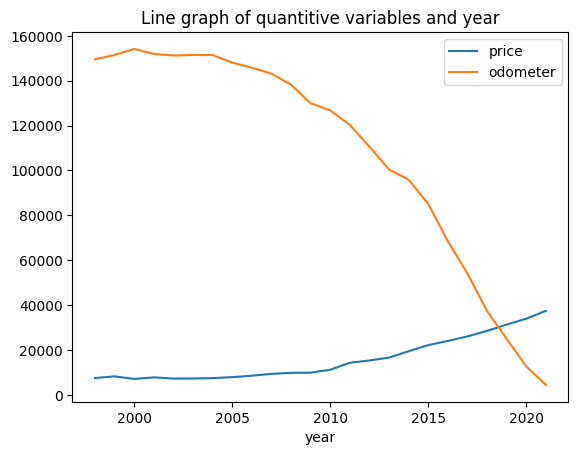

In [ ]:
# compare the average price and odometer reading per year
year_grouped = data.iloc[:, 0:3].groupby('year').mean()
display(year_grouped.loc[1998:2021].plot(title = 'Line graph of quantitive variables and year'))

The average price increases for newer models. The average odometer reading decreses for newer models.

(Note: 2022 is not plotted due to few observations)

In [ ]:
type_labels = data.columns[56:69].to_list()
fig = go.Figure()
for label in type_labels:
  type_df = data[data[label]==1]
  fig.add_trace(go.Box(x=type_df['price'], name=label.split('_')[1]))

fig.update_layout(
    title="Box Plot of Vehicle Prices by Type",
    xaxis_title="Price",
    yaxis_title="type"
)


In [ ]:
# get manufacterer column names
manufacturers = [col for col in data.columns if col.startswith('manufacturer')]
# count the manufacterer
manufacturer_counts = data[manufacturers].sum().reset_index()
manufacturer_counts.columns = ['Manufacturer', 'Count']
manufacturer_counts['Manufacturer'] = manufacturer_counts['Manufacturer'].str.replace('manufacturer_', '')

fig = px.pie(manufacturer_counts, values='Count', names='Manufacturer', title='Vehicle Distribution by Manufacturer')
fig.show()

In [ ]:
# plot histogram of 4wd vs 2wd overlayed
fig = go.Figure()
# set bin width to 1000
fig.add_trace(go.Histogram(x=data[data['drive_4wd'] == 1]['price'], name='4wd', histnorm='percent', marker_color='blue', xbins=dict(size=1000)))
fig.add_trace(go.Histogram(x=data[data['drive_fwd'] == 1]['price'], name='fwd', histnorm='percent', marker_color='red', xbins=dict(size=1000)))

fig.update_layout(barmode='overlay', title='Histogram of price for 4wd and fwd cars', xaxis_title='Price', yaxis_title='Percentage')
fig.update_traces(opacity=0.5)
# set width to 500
fig.update_layout(width=500)
fig.show()

# Model Building

### Linear Regression Model

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
import numpy as np

X = data.drop(columns='price')
y = data['price']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model = LinearRegression()
model.fit(X_train, y_train)
y_pred = model.predict(X_train)
rmse = np.sqrt(mean_squared_error(y_train, y_pred))
print(f"RMSE (train): {rmse}")

R2 = r2_score(y_train, y_pred)
print(f"R2 (train): {R2}")


# compare this to a baseline model
y_baseline = np.mean(y_train)
rmse_baseline = np.sqrt(mean_squared_error(y_train, [y_baseline] * len(y_train)))
print(f"Baseline RMSE (train): {rmse_baseline}")

R2 = r2_score(y_train, [y_baseline] * len(y_train))
print(f"Baseline R2 (train): {R2}")

RMSE (train): 6155.070300138262
R2 (train): 0.7524687133188969
Baseline RMSE (train): 12371.374901243733
Baseline R2 (train): 0.0


Test Set

In [ ]:
y_pred = model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f"RMSE: {rmse}")

R2 = r2_score(y_test, y_pred)
print(f"R2: {R2}")


# compare this to a baseline model
y_baseline = np.mean(y_train)
rmse_baseline = np.sqrt(mean_squared_error(y_test, [y_baseline] * len(y_test)))
print(f"Baseline RMSE: {rmse_baseline}")

R2 = r2_score(y_test, [y_baseline] * len(y_test))
print(f"Baseline R2: {R2}")

RMSE: 6171.435397025017
R2: 0.7532288980117458
Baseline RMSE: 12423.359320301228
Baseline R2: -4.421281918354225e-08


### Random Forest Regressor

In [ ]:

# now try a random forest regressor
from sklearn.ensemble import RandomForestRegressor

model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_train)
rmse = np.sqrt(mean_squared_error(y_train, y_pred))
print(f"Random Forest RMSE (train): {rmse}")

R2 = r2_score(y_train, y_pred)
print(f"R2 (train): {R2}")

Random Forest RMSE (train): 1372.0239093429004
R2 (train): 0.98770050094859


Test Set

In [ ]:
y_pred = model.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f"Random Forest RMSE: {rmse}")

R2 = r2_score(y_test, y_pred)
print(f"R2: {R2}")

Random Forest RMSE: 3619.2778341805647
R2: 0.9151277389287402
